# CMPINF 2100: Final exam - Main Notebook

## VASANTH MADHAVAN SRINIVASA RAGHAVAN

First Name: VASANTH MADHAVAN | Last Name: SRINIVASA RAGHAVAN

### **Detailed Notebooks**

1. 🔍 **Exploratory Data Analysis (EDA)** - [ipynb](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_2_EDA.ipynb)|[html](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_2_EDA.html)
2. ✨ **Clustering** - [ipynb](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_3_Clustering.ipynb)|[html](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_3_Clustering.html)
3. 🤖 **Model and Performance** - [ipynb](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_4_Modeling.ipynb)|[html](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_4_Modeling.html)


## A. Introduction

* **a.b.c. Are you working on a REGRESSION or CLASSIFICATION problem?**

    The given problem can be approached as both REGRESSION OR CLASSIFICATION problem. I have decided to approach this as a **classification** problem by categorizing tracks with popularity < 50  as 0 (Unpopular) and songs with popularity > 50 as 1 (Popular) in a new columns called as `track_popularity_bin`. The goal is to come up with a classification model that would classify a track based on the characteristics as 0 or 1

* **d. Describe the major findings you have identified based on your analysis.**

    1. Continuous variables that represent the characteristics of a track (danceability, energy, loudness, valence, tempo, duration_ms etc.,) influence the response (target) variable - track_popularity
    2. The genre of the music also influences the track_popularity
    3. Certain genres are very unpopular compared to the others
    4. In general songs that have shorter `duration_ms` and high `loudness` tend to be more popular
    5. Model with complex formula tend to perform better
    
* **e. Which inputs/features seem to influence the response/outcome the most?**

    Following variables are the final input variables I have identifed after EDA

    1. duration_ms
    2. loudness
    3. energy
    4. playlist_genre

* **f. What supported your conclusion? Was it only through predictive models?**

    * Predictive Models, their coefficients and cross-validation
    * Also, following visualizations helped with identifying the potential input-to-output relationships

       1. Conditional Distribution of continuous variables GROUPED BY the response (target) variable
       2. Relationships between continuous variables GROUPED BY the response (target) variable
       3. Conditional Distribution of continuous variables GROUPED BY the response (target) variable and additional categorical variable
    
* **g. Could EDA help identify similar trends/relationships?**
    
    * No

* **h. Was clustering consistent with any conclusions from the predictive models?**

    * No, it was not consistent

* **i. What skills did you learn from going through this project?**

    1. Building a machine learning model from scratch
    2. Data Exploration
    3. Clustering
    4. Model Fitting
    5. Model Performance validation techniques
    
*   **j. What general skills can you take away from the project to apply to applications more specific to your area of interest?**
    
    * I will be leveraging the various modeling techniques that I learnt in this project and use it in my area of interest - finance

## Import Required Modules

In [252]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.cluster import hierarchy
import statsmodels.formula.api as smf\

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold

In [253]:
sns.set_palette("colorblind")

In [254]:
songs_url = 'https://raw.githubusercontent.com/rfordatascience/tidytuesday/master/data/2020/2020-01-21/spotify_songs.csv'

df = pd.read_csv(songs_url)

## B. Exploratory Data Analysis (EDA)

### Basic Information

In [255]:
df.shape

(32833, 23)

In [256]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  32833 non-null  object 
 1   track_name                32828 non-null  object 
 2   track_artist              32828 non-null  object 
 3   track_popularity          32833 non-null  int64  
 4   track_album_id            32833 non-null  object 
 5   track_album_name          32828 non-null  object 
 6   track_album_release_date  32833 non-null  object 
 7   playlist_name             32833 non-null  object 
 8   playlist_id               32833 non-null  object 
 9   playlist_genre            32833 non-null  object 
 10  playlist_subgenre         32833 non-null  object 
 11  danceability              32833 non-null  float64
 12  energy                    32833 non-null  float64
 13  key                       32833 non-null  int64  
 14  loudne

In [257]:
df.dtypes

track_id                     object
track_name                   object
track_artist                 object
track_popularity              int64
track_album_id               object
track_album_name             object
track_album_release_date     object
playlist_name                object
playlist_id                  object
playlist_genre               object
playlist_subgenre            object
danceability                float64
energy                      float64
key                           int64
loudness                    float64
mode                          int64
speechiness                 float64
acousticness                float64
instrumentalness            float64
liveness                    float64
valence                     float64
tempo                       float64
duration_ms                   int64
dtype: object

In [258]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

In [259]:
df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

### Create a target variable - track_populairy_bin (y)

In [260]:
# Create a target variable - track_populairy_bin (y)

df['track_popularity_bin'] = np.where( df.track_popularity > 50, 1, 0 )
df = df.astype({'track_popularity_bin': 'object'})
df.track_popularity_bin.value_counts(normalize=True)

track_popularity_bin
0    0.574757
1    0.425243
Name: proportion, dtype: float64

### Handling Duplicates

In [261]:
#  Removing duplicates - More details in the EDA notebook
df.drop_duplicates(subset=['track_id'], keep='first', inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28356 entries, 0 to 32832
Data columns (total 24 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  28356 non-null  object 
 1   track_name                28352 non-null  object 
 2   track_artist              28352 non-null  object 
 3   track_popularity          28356 non-null  int64  
 4   track_album_id            28356 non-null  object 
 5   track_album_name          28352 non-null  object 
 6   track_album_release_date  28356 non-null  object 
 7   playlist_name             28356 non-null  object 
 8   playlist_id               28356 non-null  object 
 9   playlist_genre            28356 non-null  object 
 10  playlist_subgenre         28356 non-null  object 
 11  danceability              28356 non-null  float64
 12  energy                    28356 non-null  float64
 13  key                       28356 non-null  int64  
 14  loudness   

### Analyzing and Visualizing Categorical Variables

In [262]:
df.describe(include='object')

,track_id,track_name,track_artist,track_album_id,track_album_name,track_album_release_date,playlist_name,playlist_id,playlist_genre,playlist_subgenre,track_popularity_bin
count,28356,28352,28352,28356,28352,28356,28356,28356,28356,28356,28356
unique,28356,23449,10692,22545,19743,4530,448,470,6,24,2
top,6f807x0ima9a1j3VPbc7VN,Breathe,Queen,5L1xcowSxwzFUSJzvyMp48,Greatest Hits,2020-01-10,Indie Poptimism,72r6odw0Q3OWTCYMGA7Yiy,rap,southern hip hop,0
freq,1,18,130,42,135,201,294,100,5401,1583,17850


❌ There are far too many unique values in the columns `track_artist`, `playlist_name`, `track_album_name`, `track_name`. This makes these columns not very useful for training a model and it is not practical to show visualization for these columns. Note: Reg visualization I confirmed with the instructor on the Coursera Discussion Forum that it is not necessary to show visualization for categorical variables with far too many unique values.

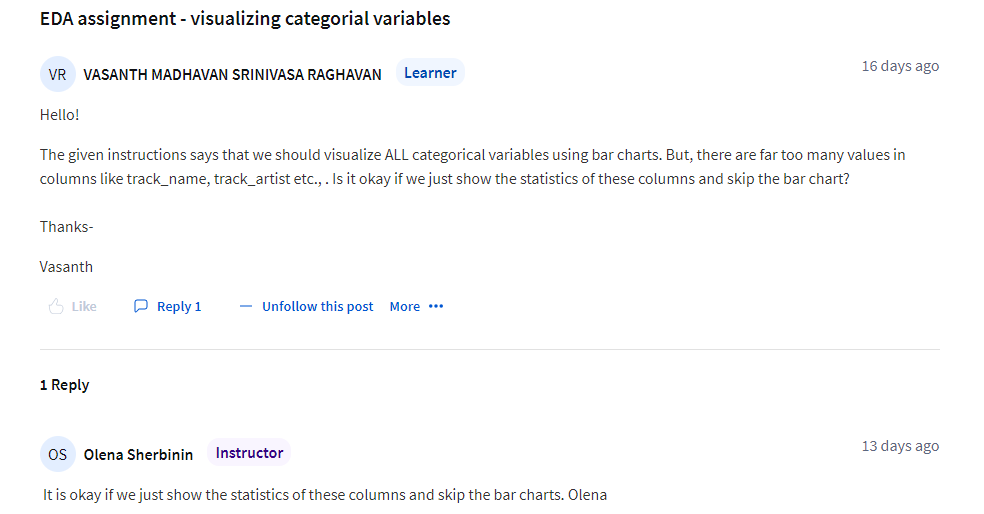

❌ Identifier columns like `track_id`, `track_album_id` and `playlist_id` will also not be very useful

In [263]:
df.drop(['track_id','track_album_id','playlist_id','track_artist','playlist_name', 'track_name', 'track_album_name'],
        inplace=True,
        axis=1)

#### Create new columns

The given data presents us with the opportunity to create additional columns. These new columns may have an impact on the target variable.

In this case, I have used  the column `track_album_release_date` to create two new columns `release_year` and `release_month`

In [264]:
df['track_album_release_date'] = pd.to_datetime(df['track_album_release_date'],  format='mixed')

In [265]:
df['release_year'] = df.track_album_release_date.dt.year

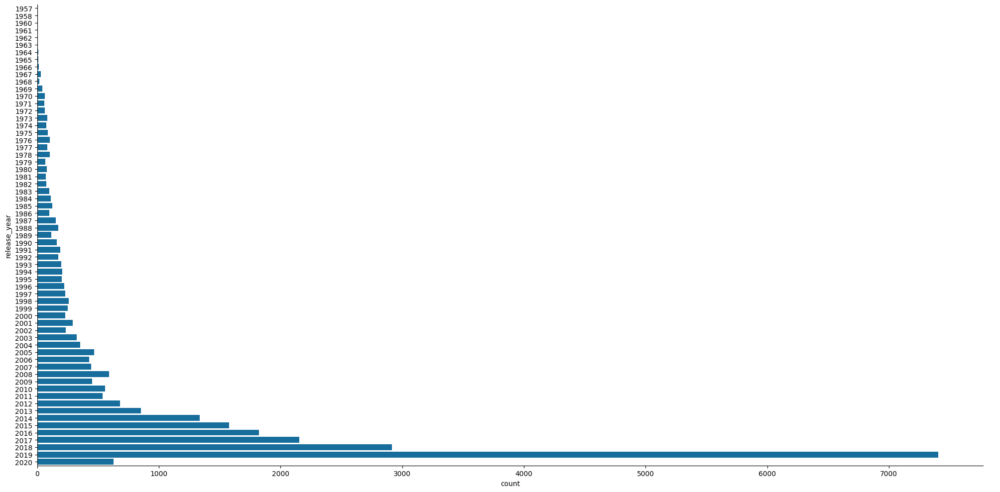

In [266]:
sns.catplot(data = df, y='release_year', kind='count', height=10, aspect=2)

plt.show()

💡 As seen above, the dataset is mostly made of songs released in the recent years rather than older years. This suggests that we can probably create one more variable that represents the release_year in two buckets. We can put songs released after 2010 in one bucket and songs released before 2010 in another

In [267]:
df['release_year_bin'] = np.where( df.release_year < 2010 , 'older', 'recent')

In [268]:
df['release_month'] = df.track_album_release_date.dt.month

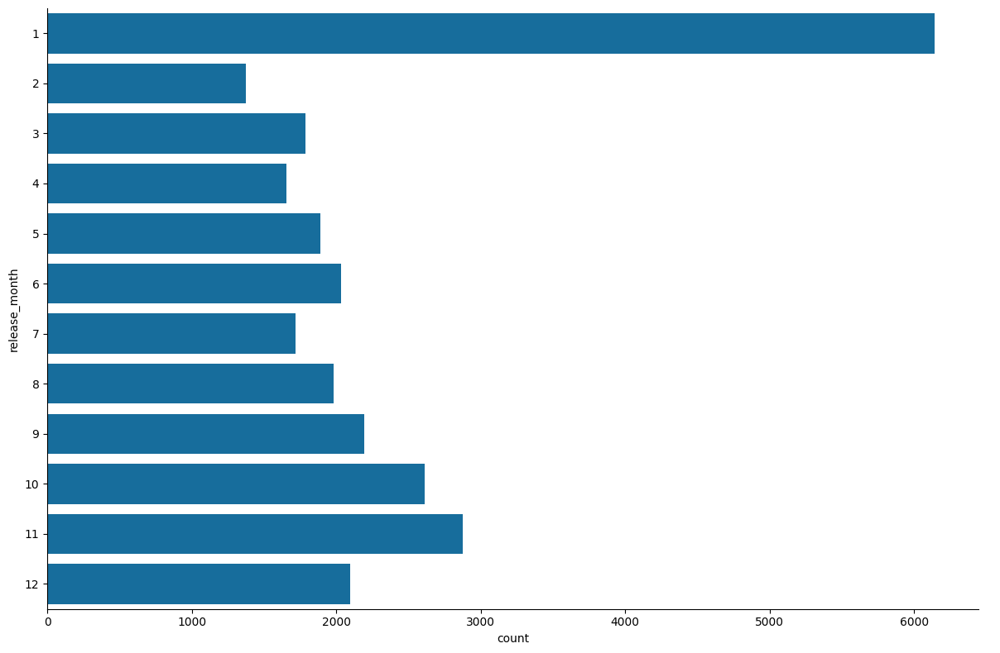

In [269]:
sns.catplot(data = df, y='release_month', kind='count', height=8, aspect=1.5)

plt.show()

💡 Majority of songs in the given dataset are release in the month of Jan

Since, `track_album_release_date` has been split into `release_year` and `release_month` the column can be dropped

In [270]:
df.drop(['track_album_release_date'], axis=1, inplace=True)

💡 Let's visualize additional variables - `key` and `mode`

Although, `key` and `mode` are numeric columns, since there are less unique values these can be considered as categorical variables

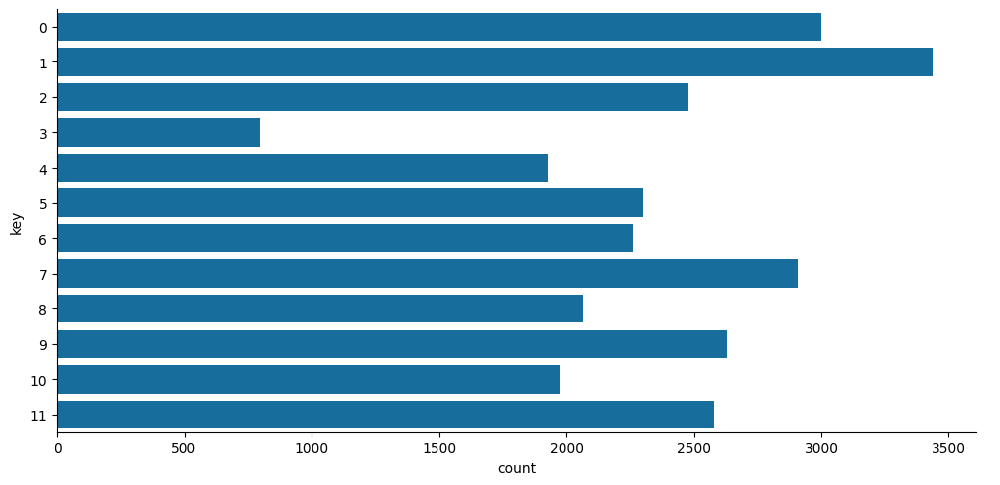

In [271]:
sns.catplot(data = df, y='key', kind='count', height=5, aspect=2)

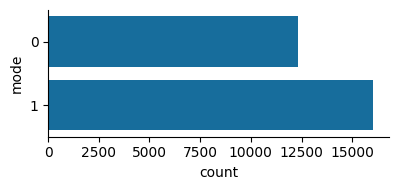

In [272]:
sns.catplot(data = df, y='mode', kind='count', height=2, aspect=2)

### Analyzing and Visualizing Continous Variables

In [273]:
df.describe()

,track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,release_year,release_month
count,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.000000,28356.00000,28356.000000,28356.000000,28356.000000
mean,39.329771,0.653372,0.698388,5.368000,-6.817696,0.565489,0.107954,0.177176,0.091117,0.190958,0.510387,120.95618,226575.967026,2011.054027,6.101813
std,23.702376,0.145785,0.183503,3.613904,3.036243,0.495701,0.102556,0.222803,0.232548,0.155894,0.234340,26.95456,61078.450819,11.229221,3.841027
min,0.000000,0.000000,0.000175,0.000000,-46.448000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,4000.000000,1957.000000,1.000000
25%,21.000000,0.561000,0.579000,2.000000,-8.309250,0.000000,0.041000,0.014375,0.000000,0.092600,0.329000,99.97200,187742.000000,2008.000000,2.000000
50%,42.000000,0.670000,0.722000,6.000000,-6.261000,1.000000,0.062600,0.079700,0.000021,0.127000,0.512000,121.99300,216933.000000,2016.000000,6.000000
75%,58.000000,0.760000,0.843000,9.000000,-4.709000,1.000000,0.133000,0.260000,0.006570,0.249000,0.695000,133.99900,254975.250000,2019.000000,10.000000
max,100.000000,0.983000,1.000000,11.000000,1.275000,1.000000,0.918000,0.994000,0.994000,0.996000,0.991000,239.44000,517810.000000,2020.000000,12.000000


In [274]:
df_features = df.select_dtypes('number').copy()
df_features.drop(['track_popularity'], axis=1, inplace=True) # Dropping Target variable

In [275]:
df_objects = df.select_dtypes('object').copy()

In [276]:
id_cols = ['rowid', 'track_popularity'] + df_objects.columns.to_list()

In [277]:
df_lf = df.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=id_cols, value_vars=df_features.columns)

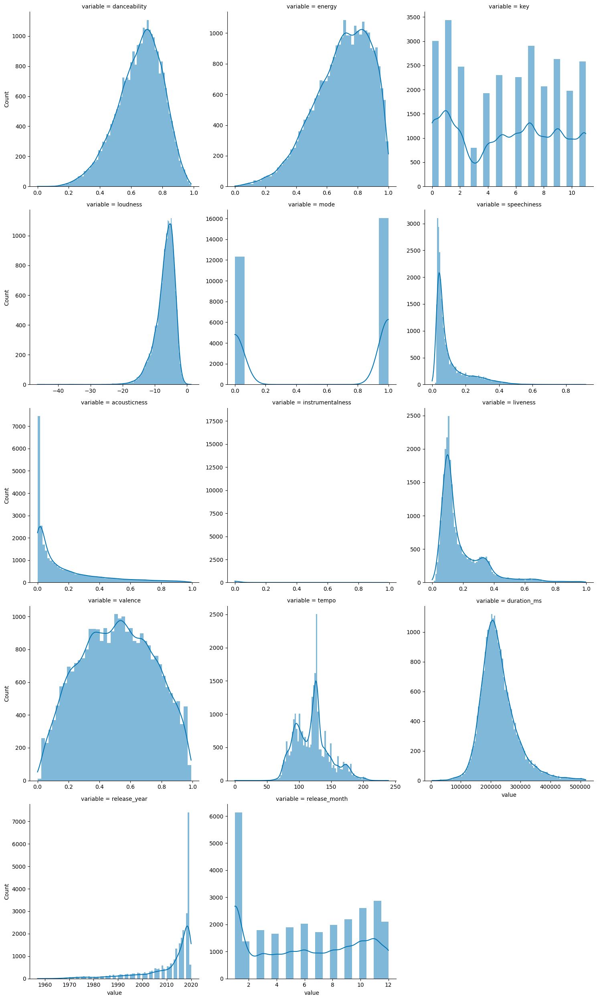

In [278]:
sns.displot(data = df_lf, x='value', col='variable', kind='hist', kde=True,
            facet_kws={'sharex': False, 'sharey': False},
            common_bins=False,
            col_wrap=3)
plt.subplots_adjust(hspace=0.5)
plt.tight_layout()
plt.tight_layout()
plt.show()

#### 💡 Observation

* We can see that  speechiness, instrumentalness, liveness, acousticness and duration_ms are skewed right.

* loudness, mode are skewed left.

* Only danceability, energy, valence, tempo have normal / approx normal distribution.

📌 Before we can use the data for modeling, we must transform the left and right skewed features have more symmetrical and bell-shaped distributions.

### Visualizing Relationships

### Categorical-to-categorical relationships

##### track_popularity_bin Vs playlist_genre

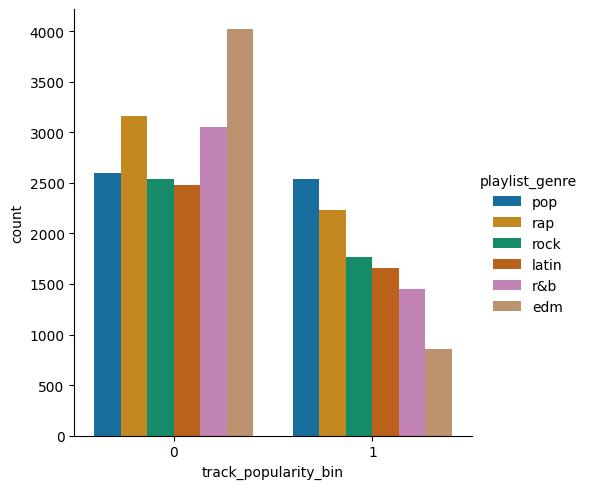

In [279]:
sns.catplot( data = df, x='track_popularity_bin', hue='playlist_genre', kind='count' )

plt.show()

💡 The above visualization between `track_popularity_bin` and `playlist_genre` using **DODGED BAR CHART** shows that the `edm` genre is the most unpopular genre. Other genres have approx same number of tracks across both unpopular and popular categories. We can also see that `pop` and `rap` are the most popular genres

#### playlist_subgenre Vs playlist_genre

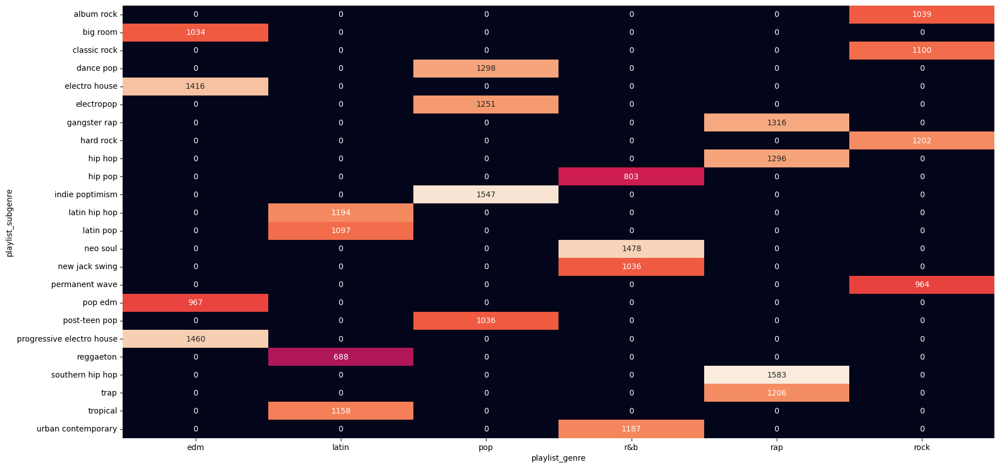

In [280]:
fig, ax = plt.subplots(figsize=(20,10))

sns.heatmap( pd.crosstab( df.playlist_subgenre, df.playlist_genre ), ax = ax,
             annot=True, annot_kws={'size': 10}, fmt='d',
             cbar=False)

plt.show()

📌 Above heatmap shows that the `playlist_subgenre` is highly correlated with `playlist_genre`. With this information, `playlist_subgenre` field can be **dropped** from the dataset as having highly correlated variables doesn't add a lot of value for the final model.

In [281]:
df.drop(columns=['playlist_subgenre'], inplace=True)

#### Categorial to Continuous

##### Key Vs Track Popularity

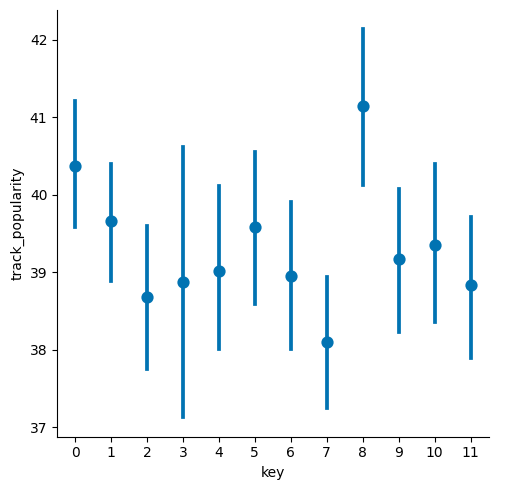

In [282]:
sns.catplot( data = df, x='key', y='track_popularity', kind='point', linestyle='none')

plt.show()

💡 Tracks with higher popularity tend to have higher value for `key`

#### Mode Vs Track Popularity

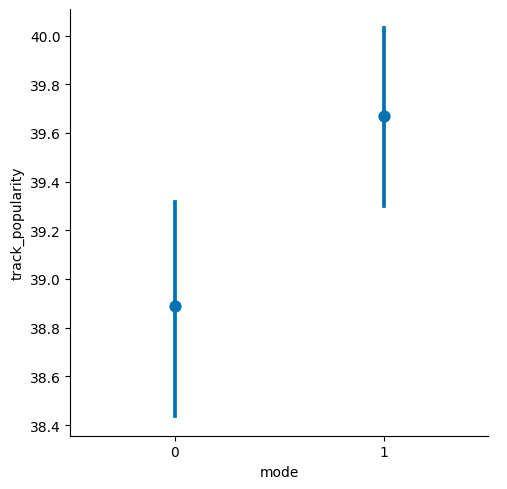

In [283]:
sns.catplot( data = df, x='mode', y='track_popularity', kind='point', linestyle='none')

plt.show()

💡 Tracks with higher popularity tend to have 1 as the `mode`

#### Continuous-to-Continuous Relationships

##### Corr plot for ALL variables

Correlation plot is one of the very effective way to view the relationships between continuous variables

Below is the corr plot for the given dataset

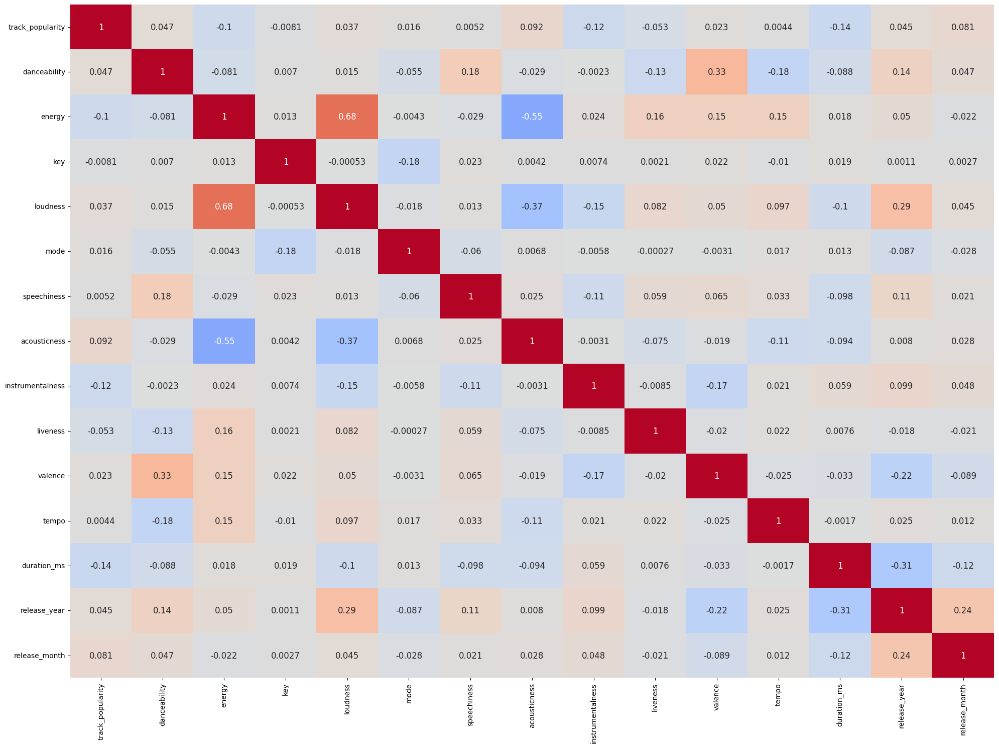

In [284]:
fig, ax = plt.subplots(figsize=(20,15))

sns.heatmap(data = df.select_dtypes('number').corr(numeric_only=True),
            vmin=-1, vmax=1, center=0,
            cmap='coolwarm', cbar=False,
            annot=True, annot_kws={'size': 12},
            ax=ax)
plt.tight_layout()
plt.show()

💡 The above plot reveals the following
1. `energy` and `loudness` are highly positively correlated
2. `energy` and `acousticness` are highly negatively correlated
3. `track_popularity` has a low correlation with all other variables. This is good because we can use the other variables to "predict" track popularity

##### **Next, visualizing the relationships between few different continuous variables**

###### duration_ms Vs loudness

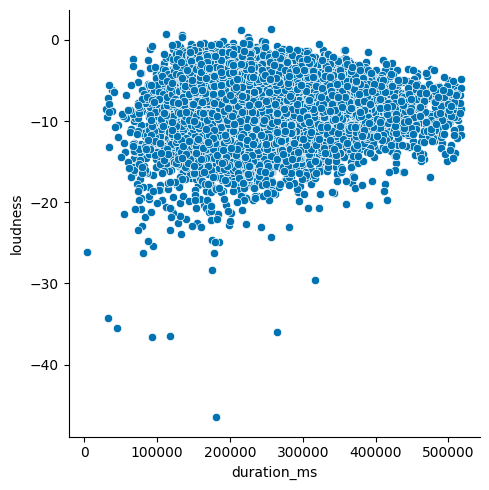

In [285]:
sns.relplot(data = df, x='duration_ms', y='loudness')

plt.show()

💡 Tracks that are longer tend to be less louder

###### acousticness Vs loudness

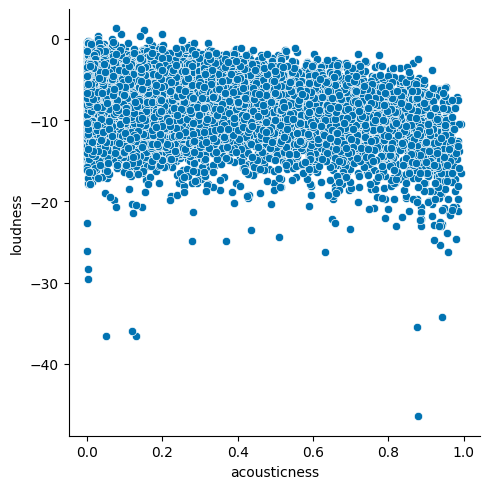

In [286]:
sns.relplot(data = df, x='acousticness', y='loudness')

plt.show()

💡 Tracks that are more acoustic tend to be less louder than the tracks that are less acoustic

###### valence Vs danceability

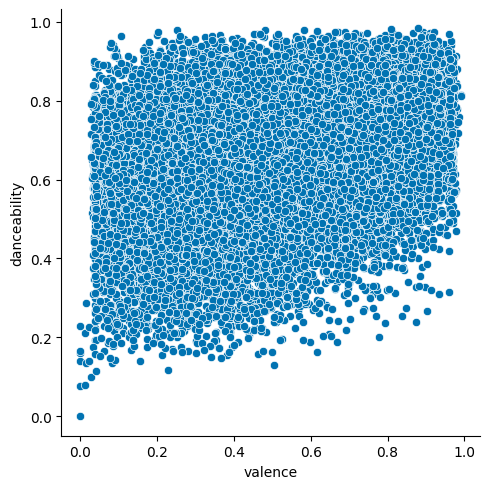

In [287]:
sns.relplot(data = df, x='valence', y='danceability')

plt.show()

💡 Danceability of tracks increase with increase in valence

#### Visualize conditional distributions of the continuous inputs GROUPED BY the response (outcome) unique values

Will be visualizing the conditional distribution of continuous inputs group by the response variable `track_popularity_bin`

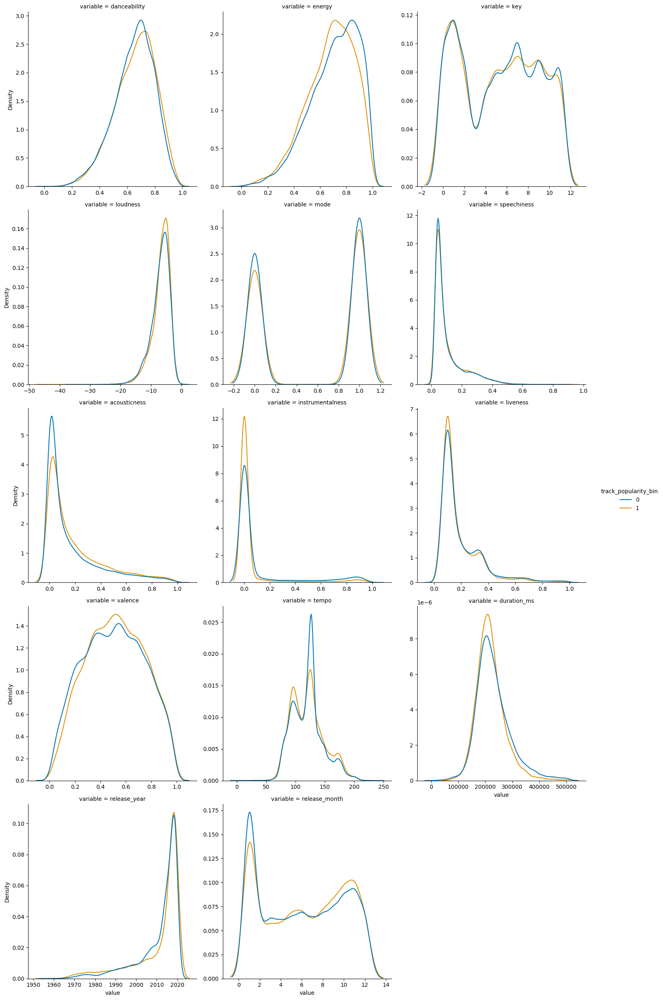

In [288]:
sns.displot(data = df_lf, x='value', col='variable', kind='kde',
            hue='track_popularity_bin',
            facet_kws={'sharex': False, 'sharey': False},
            common_norm=False,
            col_wrap=3
           )

plt.show()

💡 **Observations**
* `danceability` of popular songs (track_popularity_bin=1) is higher than the unpopular songs (track_popularity_bin=0)
* `acousticness` on popular songs is lower than the unpopular songs
* popular songs tend to have lesser duration compared to the unpopular songs

#### Visualize relationships between continuous inputs GROUPED BY the response (outcome) unique values

Here, leveraging PAIR PLOT to visualize the relationships between continuous inputs GROUPED BY the response (outcome) unique values

🚨 Splitting into two pair plot because notebook gets stuck

**PAIR PLOT - 1**

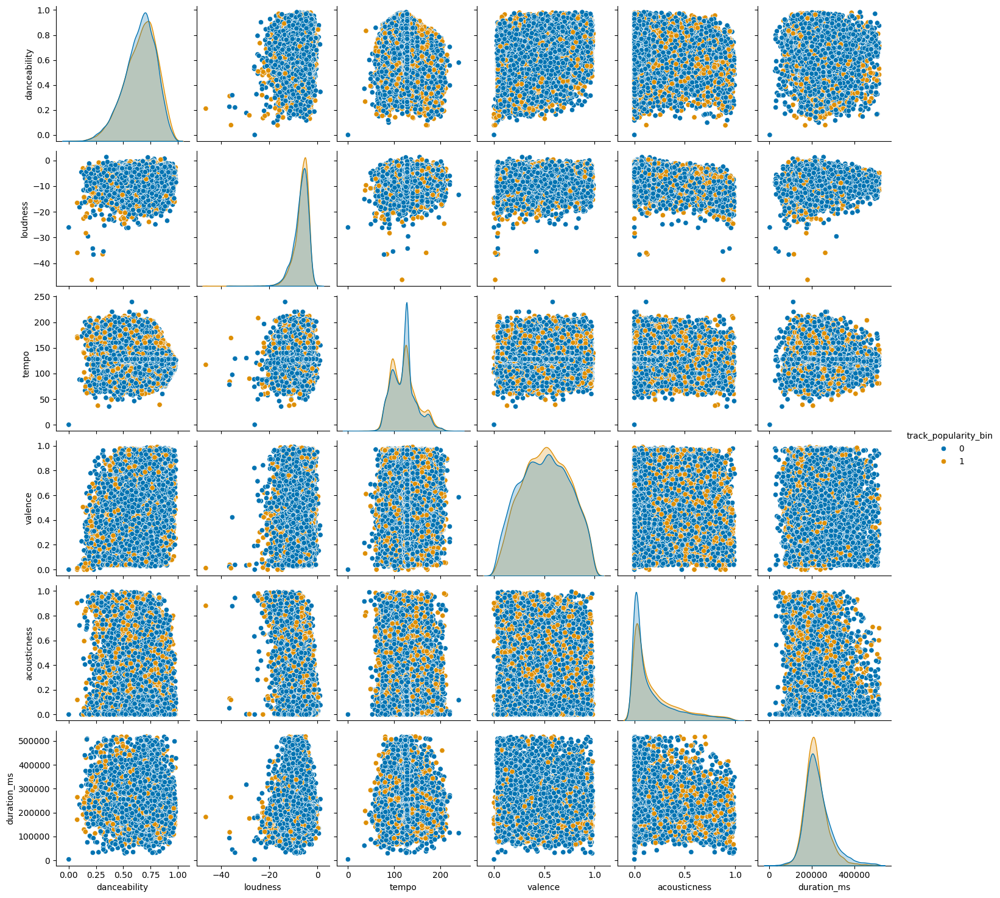

In [289]:
sns.pairplot(data=df[[ 'danceability', 'loudness', 'tempo',
                      'valence', 'acousticness',
                      'duration_ms', 'track_popularity_bin']],
             hue='track_popularity_bin',
             diag_kws={'common_norm': False})

plt.show()

💡 **Observations**
1. Popular tracks tend (track_popularity_bin=1) to be louder and shorter
2. The `danceability` increases as `tempo` increases
3. Popular songs tend to have higher tempo(track_popularity_bin=1) and danceability compared to the unpopular tracks (track_popularity_bin=1)
4. Given the `tempo` and `danceability` score one can determine the popularity of a track
5. Tracks that are more acoustic tend to be less louder

**PAIR PLOT - 2**

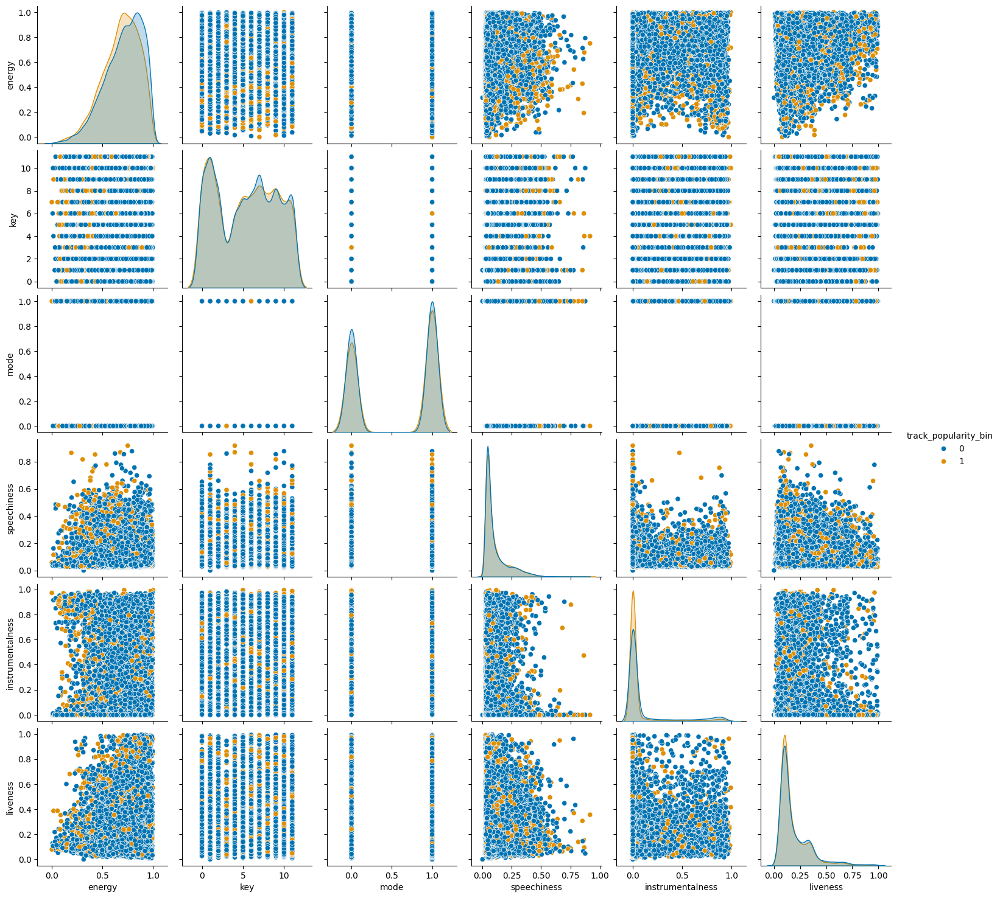

In [290]:
sns.pairplot(data=df[[ 'energy', 'key', 'mode',
                      'speechiness', 'instrumentalness',
                      'liveness', 'track_popularity_bin']],
             hue='track_popularity_bin',
             diag_kws={'common_norm': False})

plt.show()

💡 **Observations**

1. Track that have low `speechiness` tend to have high `instrumentalness`
2. Some popular tracks tend to have high `speechiness` as well as high `energy`. This could be because of tracks from `rap` genre that are speechy as well as highly energetic
3. Tracks that have high `liveness` tend to have high `energy`. This could be because songs that have high energy are more probable to be performed infront of live audience
4. Popular songs that have a `mode` of 1 tend to have high `key` value

#### Visualize the counts of combinations between the response (outcome) and categorical inputs

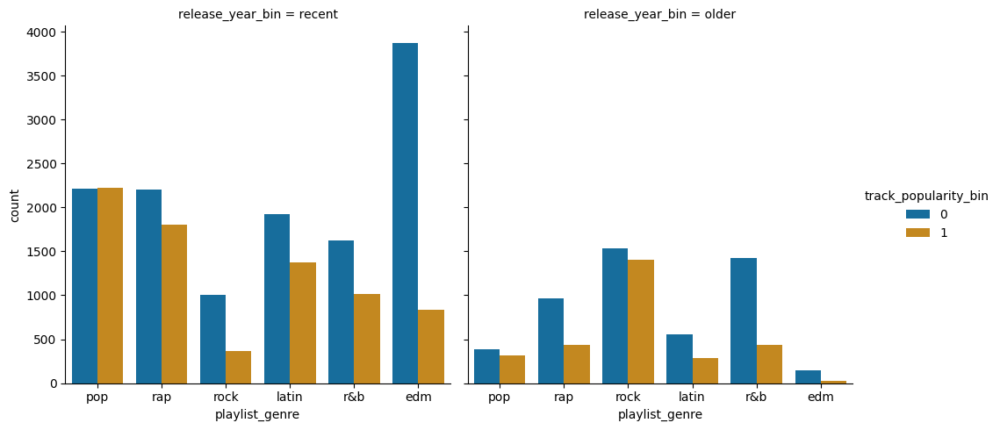

In [291]:
sns.catplot(data = df, x='playlist_genre', hue='track_popularity_bin', col='release_year_bin', kind='count', )

plt.show()

💡 **Observations**
1. `rock` used to be the most popular genre in the older years and it has been replaced by `pop` and `rap` in the recent years
2. `edm` is the most unpopular genre in the recent years

In [ ]:
# Dropping Unused columns
df.drop(columns=['track_popularity', 'release_year', 'release_month'], inplace=True)

____________________________________________

## C. Clustering

Will be attempting both KMeans and Hierarchical Clustering

Additional clustering details are available in the detailed notebook - [ipynb](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_3_Clustering) | [html](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_3_Clustering.html)

### Preprocessing

In [294]:
columns_to_use = ['danceability', 'energy', 'key', 'loudness', 'mode',
                  'speechiness', 'acousticness', 'instrumentalness',
                  'liveness', 'valence', 'tempo', 'duration_ms',
                  'track_popularity_bin', 'playlist_genre']
df_kmeans = df[columns_to_use]

In [295]:
df_features_clean = df_kmeans.select_dtypes('number').copy()

In [296]:
df_kmeans.isna().sum()

danceability            0
energy                  0
key                     0
loudness                0
mode                    0
speechiness             0
acousticness            0
instrumentalness        0
liveness                0
valence                 0
tempo                   0
duration_ms             0
track_popularity_bin    0
playlist_genre          0
dtype: int64

💡 There are no MISSING VALUES in the dataset

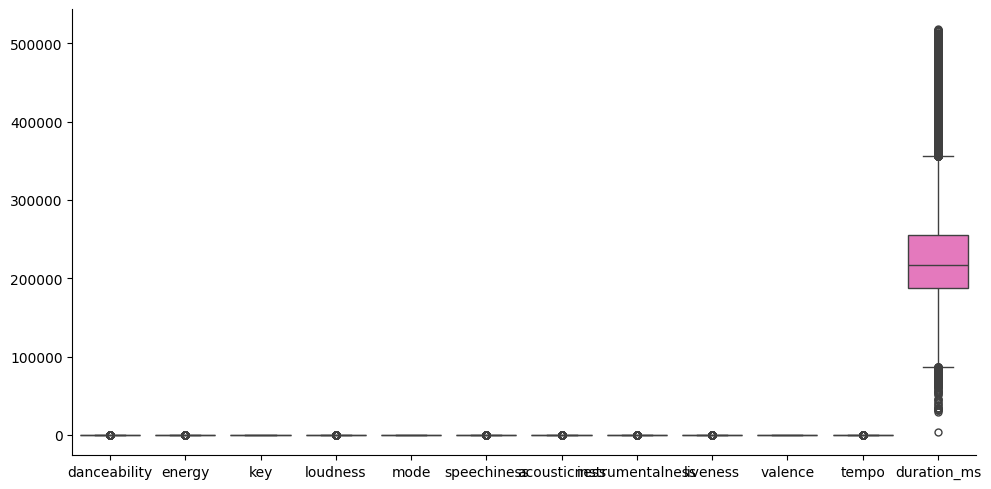

In [88]:
sns.catplot(data = df_features_clean, kind='box', aspect=2)

plt.show()

💡 **Since one variable is dominant the data has to be standardized first remove the MAGNITUDE and SCALE effect. KMeans considers SIMILAR to be based on DISTANCE. Distance depends on MAGNITUDE and SCALE**

In [89]:
X = StandardScaler().fit_transform(df_kmeans_features_clean)

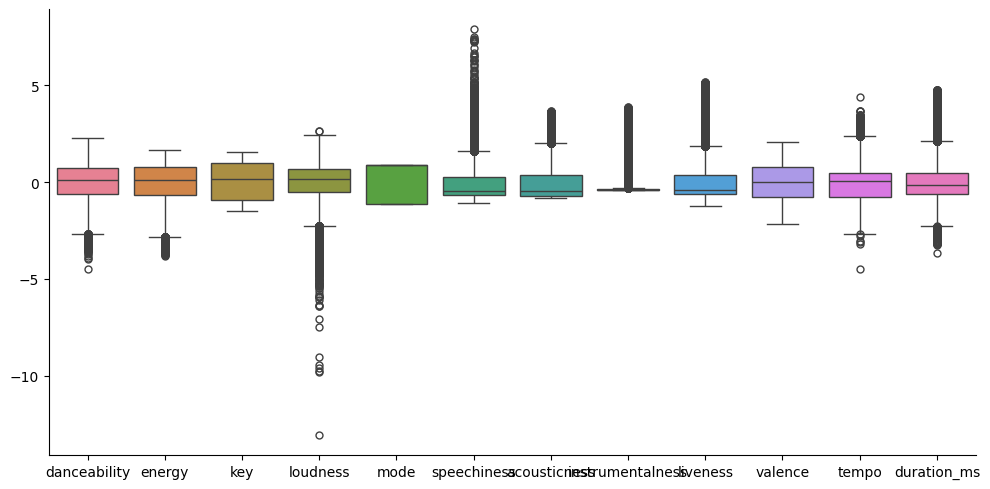

In [90]:
sns.catplot(data = pd.DataFrame(X, columns=df_features_clean.columns), kind='box', aspect=2)

plt.show()

📌 Variables have now been standardized

### KMeans

#### Initial Cluster n_clusters=2

In [92]:
clusters_2 = KMeans(n_clusters=2, random_state=121, n_init=25, max_iter=500).fit_predict(X)
df_clean_copy = df_kmeans.copy()
df_clean_copy['k2'] = pd.Series(clusters_2, index=df_clean_copy.index ).astype('category')
df_clean_copy.k2.value_counts()

k2
0    20078
1     8278
Name: count, dtype: int64

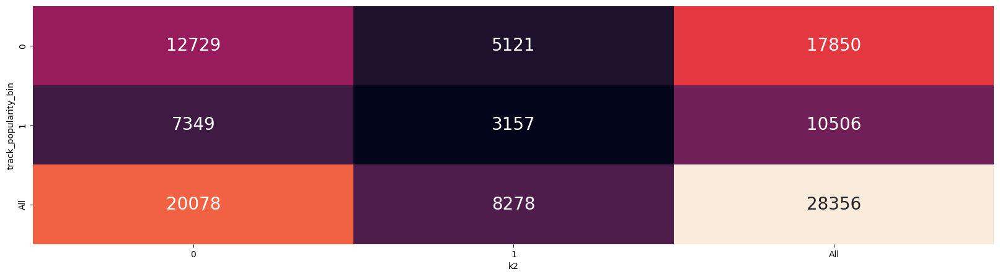

In [94]:
fig, ax = plt.subplots(figsize=(20,5))

sns.heatmap(data = pd.crosstab(df_clean_copy.track_popularity_bin,
                               df_clean_copy.k2,
                               margins=True ),
            annot=True,
            annot_kws={"fontsize": 20},
            fmt='g',
            cbar=False,
            ax=ax)

plt.show()

The above heatmap tells us that most songs have ended up in cluster 0. This suggests that more clusters are needed to find songs with distinctive characteristics that end up in the popular and unpopular categories

#### Finding Optimal number of clusters

Will be finding optimal number of clusters using the KNEE BEND PLOT!

In [96]:
tots_within = []

K = range(1, 15)

for k in K:
    km = KMeans(n_clusters=k, random_state=121, n_init=25, max_iter=500)
    km = km.fit(X)
    tots_within.append( km.inertia_ )

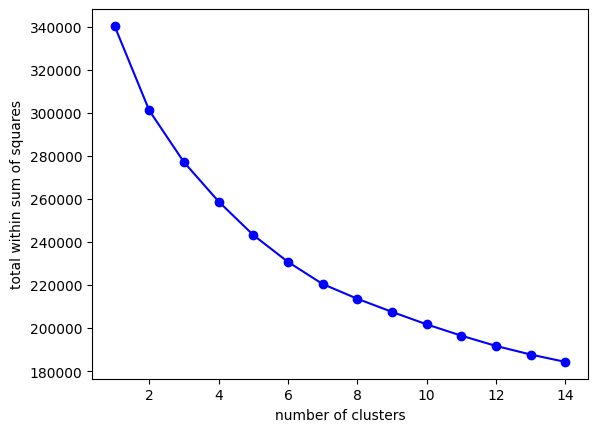

In [97]:
fig, ax = plt.subplots()

ax.plot( K, tots_within, 'bo-' )
ax.set_xlabel('number of clusters')
ax.set_ylabel('total within sum of squares')

plt.show()

📌 **Although, there isn't a clean KNEE BEND here we can see that the plot starts to bend around the cluster value of 5 and is prominent before 8. So, I have decided to go with 7 clusters for further analysis**

In [98]:
clusters_7 = KMeans(n_clusters=7, random_state=121, n_init=25, max_iter=500).fit_predict(X)

In [101]:
df_clean_copy['k7'] = pd.Series(clusters_7, index=df_clean_copy.index ).astype('category')
df_clean_copy.k7.value_counts()

k7
3    6844
4    5963
2    5038
6    3510
5    3123
0    2211
1    1667
Name: count, dtype: int64

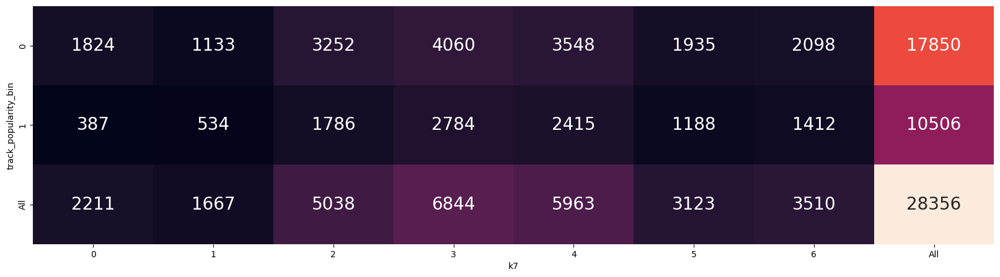

In [104]:
fig, ax = plt.subplots(figsize=(20,5))

sns.heatmap(data = pd.crosstab(df_clean_copy.track_popularity_bin,
                               df_clean_copy.k7,
                               margins=True ),
            annot=True,
            annot_kws={"fontsize": 20},
            fmt='g',
            cbar=False,
            ax=ax)

plt.show()

💡 **The above heatmap tells that clusters 0,1,2 tend to have more unpopular songs than clusters 3,4,5,6. This is much better than two clusters**

#### Visualizing relationships and conditional distributions using PAIR PLOT

Finally, using PAIR PLOT to visualize the relationships between continuous variables GROUPED BY the cluster category as well as conditional distribution of each continuous variable GROUPED BY the cluster category

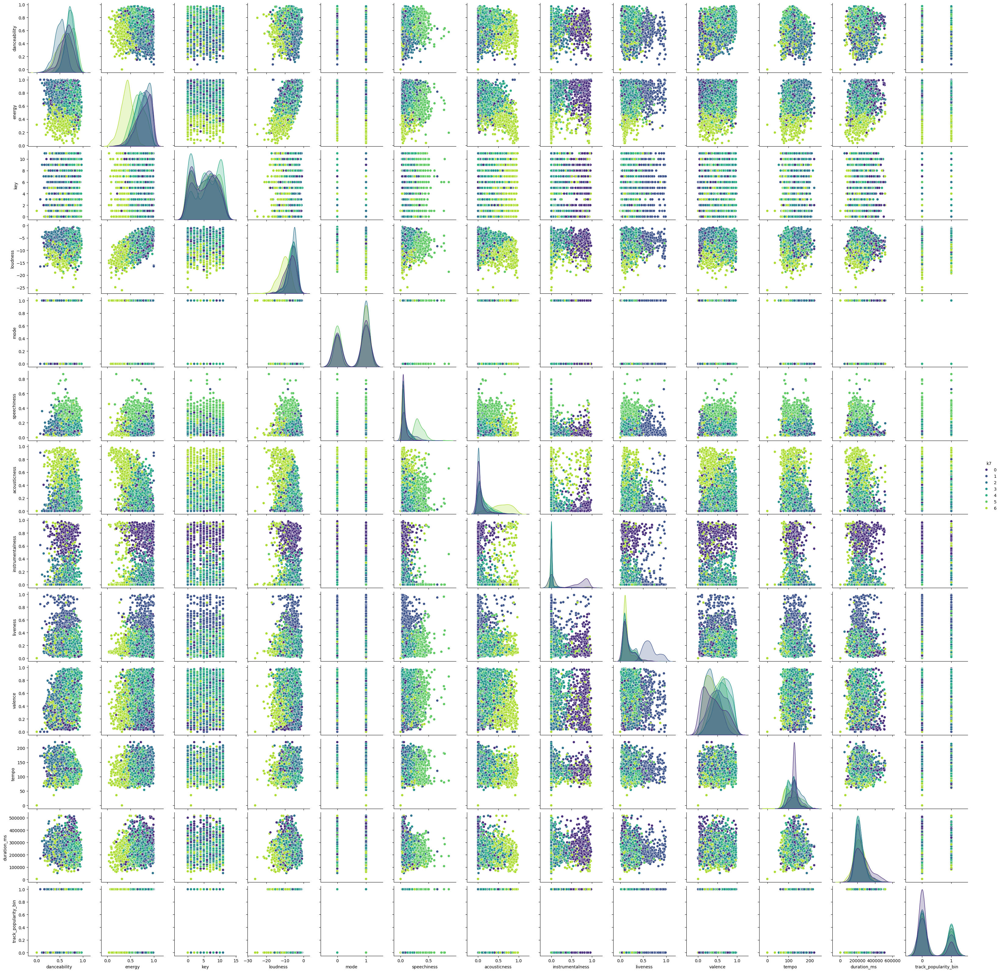

In [ ]:
# NOTE: I have used a sample of 5000 because my notebook kept crashing
sns.pairplot(data = df_clean_copy.sample(5000), hue='k7', diag_kws={'common_norm': False},
             palette='viridis')

plt.show()

💡 **Observations**

1. Tracks in the clusters 0,1,2 tend to have higher `energy` compared to the clusters 3,4,5,6
2. Tracks in cluster 5 have lower `energy` and `duration_ms` between 200000 and 300000
3. Cluster 0 seems to be made of tracks with high `instrumentalness` and high `energy`

### Hierarchical Clustering

#### Plotting the dendrogram

In [208]:
hclust_ward = hierarchy.ward(X)

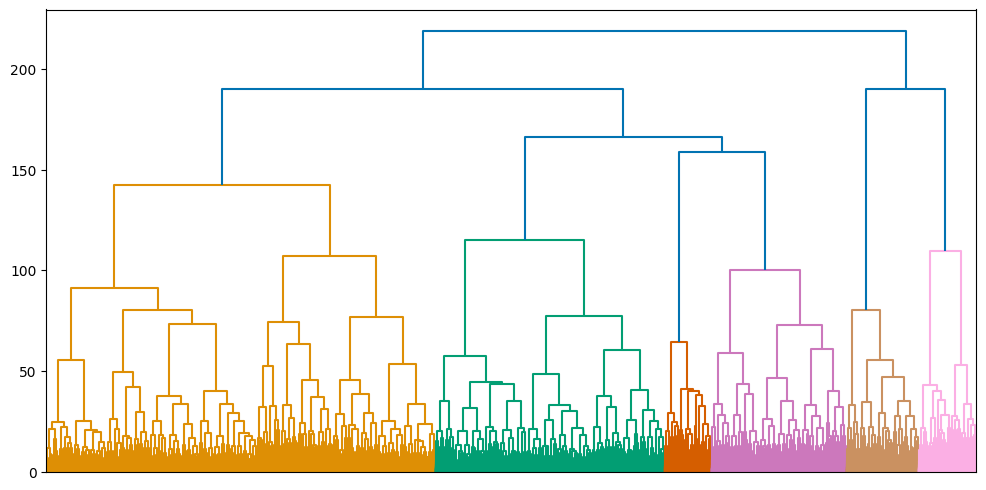

In [209]:
fig = plt.figure(figsize=(12, 6))

dn = hierarchy.dendrogram(hclust_ward, no_labels=True )

plt.show()

In [110]:
np.unique( hierarchy.cut_tree( hclust_ward, height=180).ravel() )

array([0, 1, 2, 3])

In [111]:
df_clean_copy['hclust_4'] = pd.Series( hierarchy.cut_tree( hclust_ward, height=180).ravel(),
                                              index=df_clean_copy.index ).astype('object')

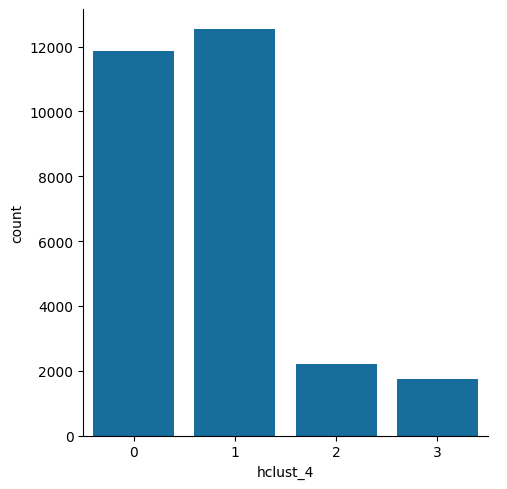

In [113]:
sns.catplot(data = df_clean_copy, x='hclust_4', kind='count')

plt.show()

#### Analyze the clusters

**Crosstab**

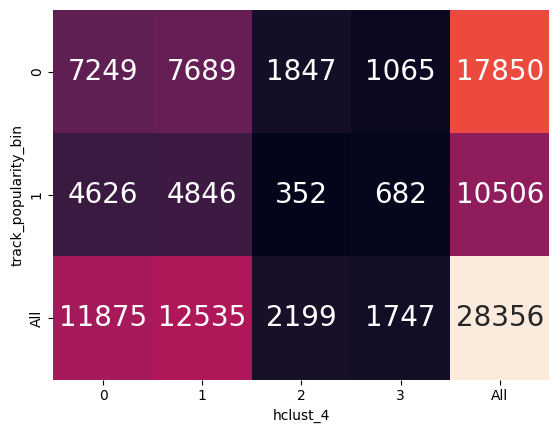

In [117]:
fig, ax = plt.subplots()

sns.heatmap(
    data = pd.crosstab(
        df.track_popularity_bin, df_clean_copy.hclust_4, margins=True,
    ),
    annot=True,
    annot_kws={'fontsize': 20}, fmt='g',
    cbar=False,
    ax=ax)

plt.show()

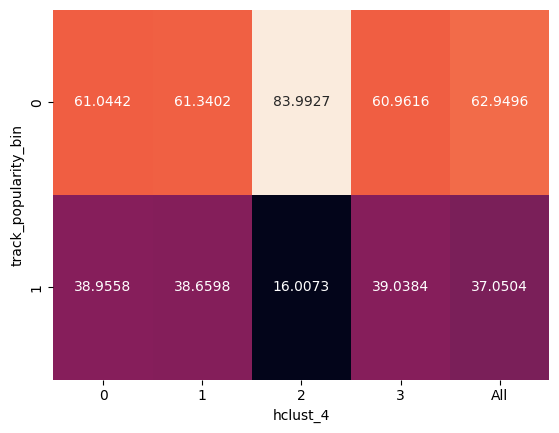

In [116]:
fig, ax = plt.subplots()

sns.heatmap(
    data = pd.crosstab(
        df.track_popularity_bin, df_clean_copy.hclust_4, margins=True, normalize='columns'
    )*100,
    annot=True,
    annot_kws={'fontsize': 10}, fmt='g',
    cbar=False,
    ax=ax)

plt.show()

💡 **Cluster 2** has the highest percentage of unpopular songs

**Visualize distribution of individual features using BOXPLOT across different clusters**

In [118]:
# Reshape to long format to enable exploring ALL of the original variables GROUPED BY the clusters!

df_clean_copy_lf = df_clean_copy.reset_index().\
rename(columns={'index': 'rowid'}).\
melt(id_vars=['rowid', 'k7', 'k2', 'hclust_4', 'track_popularity_bin'],
     value_vars=df_features_clean[
         ['danceability', 'energy', 'key', 'loudness', 'mode', 
          'speechiness', 'acousticness', 'instrumentalness', 
          'liveness', 'valence', 'tempo', 'duration_ms', 
          ]])

In [119]:
df_clean_copy_lf

,rowid,k7,k2,hclust_4,track_popularity_bin,variable,value
0,0,3,0,0,1,danceability,0.748
1,1,3,0,0,1,danceability,0.726
2,2,4,0,1,1,danceability,0.675
3,3,2,0,0,1,danceability,0.718
4,4,3,0,0,1,danceability,0.650
...,...,...,...,...,...,...,...
340267,32828,2,0,0,0,duration_ms,204375.000
340268,32829,2,0,0,0,duration_ms,353120.000
340269,32830,2,0,1,0,duration_ms,210112.000
340270,32831,2,0,0,0,duration_ms,367432.000


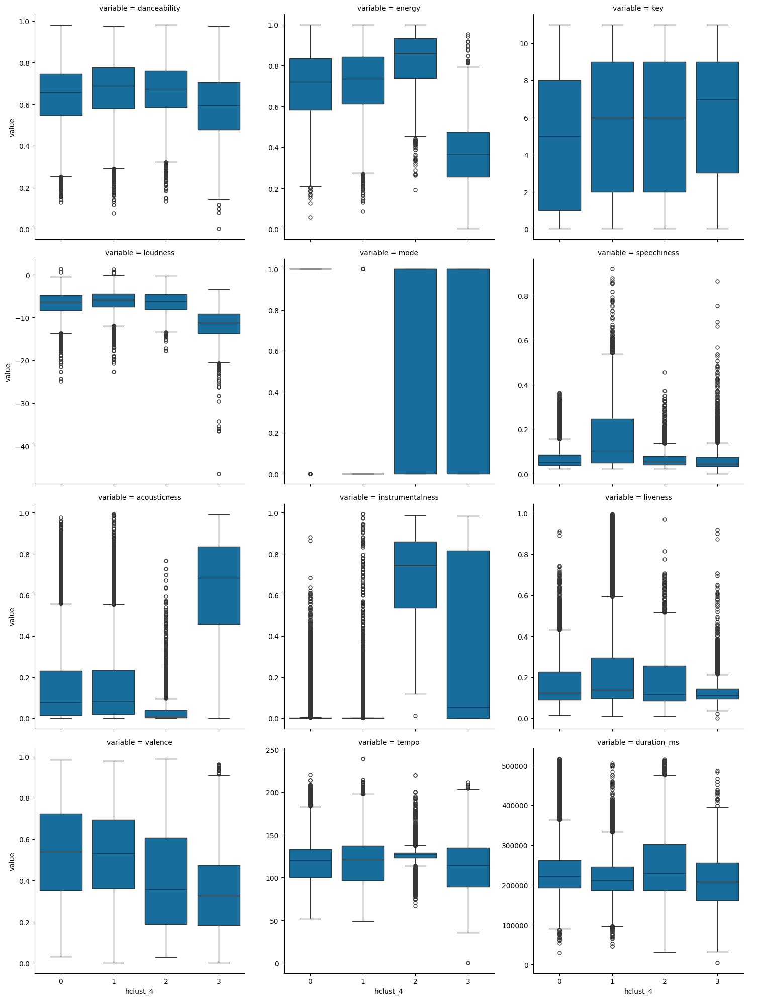

In [121]:
sns.catplot(data = df_clean_copy_lf[['hclust_4','variable','value']], 
            x='hclust_4', 
            y='value', 
            col='variable', 
            col_wrap=3,
            kind='box',
            sharey=False)

plt.show()

**💡 Observations**

1. **Danceability**
- Fairly consistent across clusters, with slight variations in medians and ranges.
- Most clusters have similar distributions, with some outliers.

2. **Energy**
- Significant variation across clusters.
- 👀 **cluster 3** has noticeably lower energy values compared to others.

3. **Key**
- Distributions appear consistent across clusters.
- Clusters do not show strong separation based on the **key**.

4. **Loudness**
- Slight variation in medians across clusters.

5. **Mode**
- 👀 Clear separation exists for this feature across clusters.

6. **Speechiness**
- Low values dominate most clusters, with a few clusters showing greater variability and high outliers.

7. **Acousticness**
- 👀 Strong differences across clusters.
- Some clusters have consistently high values, while others are lower.

8. **Instrumentalness**
- 👀 Significant variation across clusters.
- Some clusters have higher median values and larger ranges for this feature.

9. **Liveness**
- Variability in medians and ranges exists, but differences are not extreme.

10. **Valence**
- Distribution is relatively uniform across clusters.
- Slight variations in medians are observed.

11. **Tempo**
- Clear differences in medians and ranges across clusters.
- 👀 **Cluster 2** interquartile range (IQR) is very narrow compared to ther three clusters. This clearly confirms clustering of slower songs in this cluster.

12. **Duration (ms)**
- Significant separation across clusters.
- 👀 **Cluster 2** has consistently higher durations than others.

**General Insights**
1. **Distinct Clustering Features**:  
   - 💓 Features like **instrumentalness**, **duration_ms**, **acousticness**, **energy** and **tempo** show clear separation across clusters, making them key drivers of clustering.
2. **Uniform Features**:  
   - Features like **key** and **danceability** have consistent distributions, contributing less to cluster differentiation.
3. **Categorical Variables**:  
   - Features like **mode** separate clusters clearly due to their binary nature.



**Visualize relationships using PAIR PLOT**

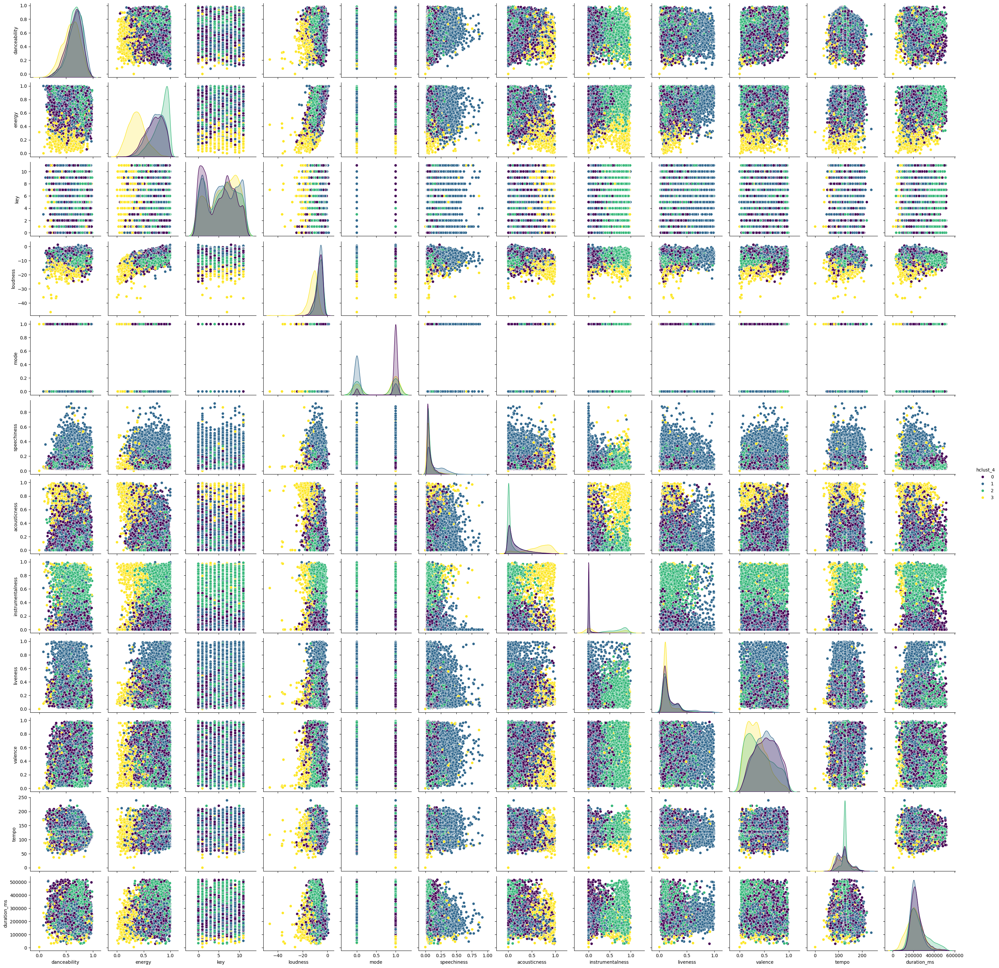

In [ ]:
sns.pairplot(data=df_clean_copy[['danceability', 'energy', 'key', 'loudness', 'mode', 
                                        'speechiness', 'acousticness', 'instrumentalness', 
                                        'liveness', 'valence', 'tempo', 'duration_ms','hclust_4']],
             hue='hclust_4', 
             diag_kws={'common_norm': False}, 
             palette='viridis')

plt.show()

**💡 Observations**

1. Songs in cluster 2 tend to have higher duration and higher instrumentalness

_________________________________________

## D. Models: Fitting and Interpretation

Additional modeling details are available in the detailed notebook - [ipynb](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_4_Modeling.ipynb) | [html](./Srinivasa_Raghavan_Vasanth_Madhavan_Final_Exam_4_Modeling.html)

### Addressing Skewness

In [204]:
# Reducing skewness by applying log transform
df['speechiness_log'] = df['speechiness'].apply(lambda x: np.log(x) if x > 0 else 0)
df['acousticness_log'] = df['acousticness'].apply(lambda x: np.log(x) if x > 0 else 0)
df['instrumentalness_log'] = df['instrumentalness'].apply(lambda x: np.log(x) if x > 0 else 0)
df['liveness_log'] = df['liveness'].apply(lambda x: np.log(x) if x > 0 else 0)
df['duration_ms_log'] = df['duration_ms'].apply(lambda x: np.log(x) if x > 0 else 0)

### Fitting

Define a function to FIT and CALCULATE the training set performance

In [205]:
def fit_and_assess_logistic(mod_name, a_formula, train_data, threshold):
    a_mod = smf.logit(formula=a_formula, data=train_data).fit()

    train_copy = train_data.copy()

    train_copy['pred_probability'] = a_mod.predict(train_data)

    train_copy['pred_class'] = np.where(train_copy.pred_probability > threshold, 1, 0 )

    TN, FP, FN, TP = confusion_matrix(train_copy.y.to_numpy(), train_copy.pred_class.to_numpy() ).ravel()

    Accuracy = (TN + TP) / (TN + FP + FN + TP)

    Sensitivity = (TP) / (TP + FN)

    Specificity = (TN) / (TN + FP)

    FPR = 1 - Specificity

    ROC_AUC = roc_auc_score(train_copy.y.to_numpy(), train_copy.pred_probability.to_numpy() )

    res_dict = {'model_name': mod_name,
                'model_formula': a_formula,
                'num_coefs': len( a_mod.params ),
                'threshold': threshold,
                'Accuracy': Accuracy,
                'Sensitivity': Sensitivity,
                'Specificity': Specificity,
                'FPR': FPR,
                'ROC_AUC': ROC_AUC}

    return pd.DataFrame( res_dict, index=[0] )

In [210]:
# Create a column `y` which is ditto of the target variable `track_popularity_bin`
# This is done so that applying formula and interpretation is easy

df['y'] = df['track_popularity_bin'] 
df = df.astype({'y': 'int'})
df = df.astype({'track_popularity_bin': 'int'})

In [211]:
fit_and_assess_logistic(0, 'y ~ 1', train_data=df, threshold=0.5)

Optimization terminated successfully.
         Current function value: 0.659223
         Iterations 4


,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,0,y ~ 1,1,0.5,0.629496,0.0,1.0,0.0,0.5


In [212]:
formula_list = [
    # Intercept Only
    'y ~ 1',
    # Categorical inputs with additive features
    'y ~ playlist_genre + key + mode',
    # Continuous inputs with linear additive features
    'y ~ tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log',
    # All Inputs
    'y ~ playlist_genre + key + mode + tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log',
    # Continuous inputs with linear main effect and pair-wise interactions.
    'y ~ (tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log) ** 2',
    # Interact the categorical inputs with the continuous inputs. This model must include the linear main effects as well (the formula interface helps with the interactions).
    'y ~ playlist_genre * (tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log)',
    # Based on EDA
    'y ~ mode * (tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log)',
    'y ~ playlist_genre * ( (tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log)**2 + np.power(tempo,2) + np.power(loudness,2) + np.power(valence,2) + np.power(danceability,2) + np.power(energy,2) + np.power(duration_ms_log,2) + np.power(speechiness_log,2) + np.power(instrumentalness_log,2) + np.power(liveness_log,2) + np.power(acousticness_log,2))',
]


In [213]:
results_list=[]
for x in range(len(formula_list)):
    results_list.append(
        fit_and_assess_logistic(x, formula_list[x], train_data = df, threshold=0.5) )

Optimization terminated successfully.
         Current function value: 0.659223
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.635441
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.642106
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.620351
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.633988
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.612935
         Iterations 7
Optimization terminated successfully.
         Current function value: 0.641314
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.597308
         Iterations 15


In [214]:
results_df = pd.concat(results_list, ignore_index=True)
results_df

,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
0,0,y ~ 1,1,0.5,0.629496,0.000000,1.000000,0.000000,0.500000
1,1,y ~ playlist_genre + key + mode,8,0.5,0.629496,0.000000,1.000000,0.000000,0.614164
2,2,y ~ tempo + loudness + valence + danceability ...,11,0.5,0.631471,0.094993,0.947227,0.052773,0.611263
3,3,y ~ playlist_genre + key + mode + tempo + loud...,18,0.5,0.645013,0.246907,0.879328,0.120672,0.661755
4,4,y ~ (tempo + loudness + valence + danceability...,56,0.5,0.638489,0.138778,0.932605,0.067395,0.629157
5,5,y ~ playlist_genre * (tempo + loudness + valen...,66,0.5,0.657215,0.283267,0.877311,0.122689,0.677108
6,6,y ~ mode * (tempo + loudness + valence + dance...,22,0.5,0.632741,0.103560,0.944202,0.055798,0.613896
7,7,y ~ playlist_genre * ( (tempo + loudness + val...,396,0.5,0.669453,0.360937,0.851036,0.148964,0.701659


In [215]:
results_df.sort_values(by=['Accuracy'], ascending=False)

,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
7,7,y ~ playlist_genre * ( (tempo + loudness + val...,396,0.5,0.669453,0.360937,0.851036,0.148964,0.701659
5,5,y ~ playlist_genre * (tempo + loudness + valen...,66,0.5,0.657215,0.283267,0.877311,0.122689,0.677108
3,3,y ~ playlist_genre + key + mode + tempo + loud...,18,0.5,0.645013,0.246907,0.879328,0.120672,0.661755
4,4,y ~ (tempo + loudness + valence + danceability...,56,0.5,0.638489,0.138778,0.932605,0.067395,0.629157
6,6,y ~ mode * (tempo + loudness + valence + dance...,22,0.5,0.632741,0.103560,0.944202,0.055798,0.613896
2,2,y ~ tempo + loudness + valence + danceability ...,11,0.5,0.631471,0.094993,0.947227,0.052773,0.611263
0,0,y ~ 1,1,0.5,0.629496,0.000000,1.000000,0.000000,0.500000
1,1,y ~ playlist_genre + key + mode,8,0.5,0.629496,0.000000,1.000000,0.000000,0.614164


In [216]:
results_df.sort_values(by=['ROC_AUC'], ascending=False)

,model_name,model_formula,num_coefs,threshold,Accuracy,Sensitivity,Specificity,FPR,ROC_AUC
7,7,y ~ playlist_genre * ( (tempo + loudness + val...,396,0.5,0.669453,0.360937,0.851036,0.148964,0.701659
5,5,y ~ playlist_genre * (tempo + loudness + valen...,66,0.5,0.657215,0.283267,0.877311,0.122689,0.677108
3,3,y ~ playlist_genre + key + mode + tempo + loud...,18,0.5,0.645013,0.246907,0.879328,0.120672,0.661755
4,4,y ~ (tempo + loudness + valence + danceability...,56,0.5,0.638489,0.138778,0.932605,0.067395,0.629157
1,1,y ~ playlist_genre + key + mode,8,0.5,0.629496,0.000000,1.000000,0.000000,0.614164
6,6,y ~ mode * (tempo + loudness + valence + dance...,22,0.5,0.632741,0.103560,0.944202,0.055798,0.613896
2,2,y ~ tempo + loudness + valence + danceability ...,11,0.5,0.631471,0.094993,0.947227,0.052773,0.611263
0,0,y ~ 1,1,0.5,0.629496,0.000000,1.000000,0.000000,0.500000


### Interpretation

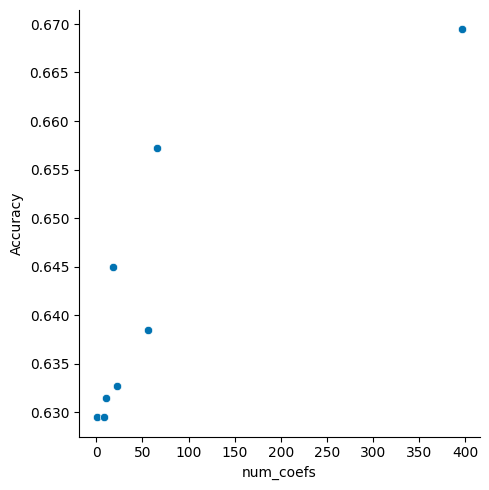

In [217]:
sns.relplot(data = results_df, x='num_coefs', y='Accuracy', kind='scatter')

plt.show()

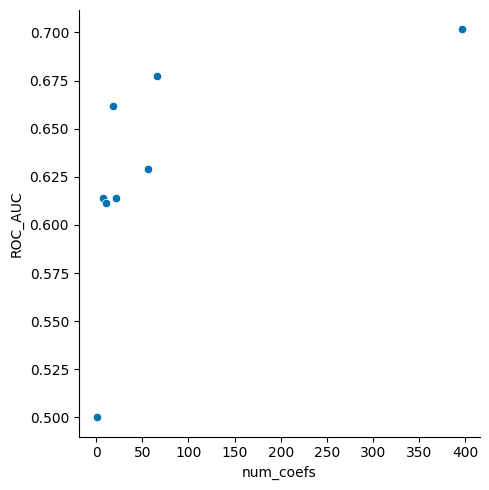

In [218]:
sns.relplot(data = results_df, x='num_coefs', y='ROC_AUC', kind='scatter')

plt.show()

Model performance gets better with more coefficients

#### Best Performing Model
* **model_name**: 7
* **model_formula**: `y ~ playlist_genre * ( (tempo + loudness + valence + danceability + energy + duration_ms_log + speechiness_log + instrumentalness_log + liveness_log + acousticness_log)**2 + np.power(tempo,2) + np.power(loudness,2) + np.power(valence,2) + np.power(danceability,2) + np.power(energy,2) + np.power(duration_ms_log,2) + np.power(speechiness_log,2) +                np.power(instrumentalness_log,2) + np.power(liveness_log,2) + np.power(acousticness_log,2))`
* **Accuracy Vs ROC** - In this case the model doesn't change between Accuracy Vs ROC. It is still model 7
* **No. of coefs**: 396
* The best model performs **better** than INTERCEPT-ONLY model

#### Visualize the entire ROC curve for each model

In [219]:
def fit_logistic_make_roc(mod_name, a_formula, train_data):
    a_mod = smf.logit(formula=a_formula, data=train_data).fit()
    
    train_copy = train_data.copy()
    
    train_copy['pred_probability'] = a_mod.predict( train_data )
    
    fpr, tpr, threshold = roc_curve( train_data.y.to_numpy(), train_copy.pred_probability.to_numpy() )
    
    res_df = pd.DataFrame({'tpr': tpr,
                           'fpr': fpr,
                           'threshold': threshold})
    
    res_df['model_name'] = mod_name
    res_df['model_formula'] = a_formula
    
    return res_df

In [220]:
roc_list = []

for m in range( len(formula_list) ):
    roc_list.append( fit_logistic_make_roc( m, formula_list[m], train_data=df))

Optimization terminated successfully.
         Current function value: 0.659223
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.635441
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.642106
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.620351
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.633988
         Iterations 6
Optimization terminated successfully.
         Current function value: 0.612935
         Iterations 7
Optimization terminated successfully.
         Current function value: 0.641314
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.597308
         Iterations 15


In [221]:
roc_df = pd.concat( roc_list, ignore_index=True )
roc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75759 entries, 0 to 75758
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   tpr            75759 non-null  float64
 1   fpr            75759 non-null  float64
 2   threshold      75759 non-null  float64
 3   model_name     75759 non-null  int64  
 4   model_formula  75759 non-null  object 
dtypes: float64(3), int64(1), object(1)
memory usage: 2.9+ MB


In [222]:
roc_df['model_name'] = roc_df.model_name.astype('category')
roc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75759 entries, 0 to 75758
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   tpr            75759 non-null  float64 
 1   fpr            75759 non-null  float64 
 2   threshold      75759 non-null  float64 
 3   model_name     75759 non-null  category
 4   model_formula  75759 non-null  object  
dtypes: category(1), float64(3), object(1)
memory usage: 2.4+ MB


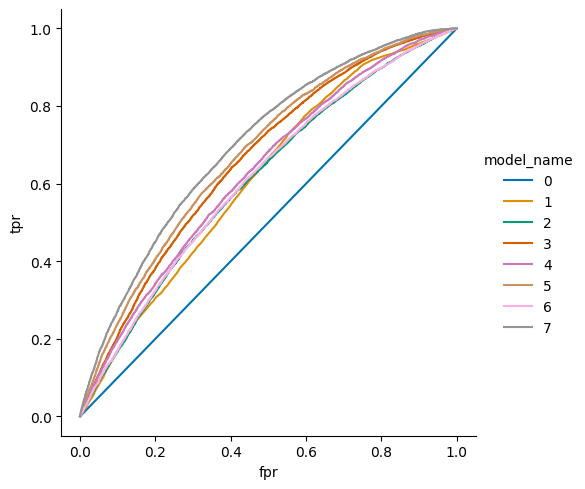

In [223]:
sns.relplot(data = roc_df, x='fpr', y='tpr', hue='model_name',
            kind='line', estimator=None,)

plt.show()

#### Identifying statistically significant features

In [224]:
# Model with all features
model_all_feat = smf.logit(formula=formula_list[3], data=df).fit()

Optimization terminated successfully.
         Current function value: 0.620351
         Iterations 6


In [225]:
print(np.abs(model_all_feat.pvalues[model_all_feat.pvalues < 0.05]).sort_values().to_string())

playlist_genre[T.pop]      2.617667e-184
playlist_genre[T.rock]     1.223407e-158
loudness                   5.572640e-108
playlist_genre[T.rap]       3.086667e-84
playlist_genre[T.latin]     5.867846e-78
energy                      3.397391e-60
playlist_genre[T.r&b]       2.052120e-35
Intercept                   6.860019e-16
acousticness_log            1.010851e-15
duration_ms_log             3.554137e-15
danceability                3.869361e-10
tempo                       1.036601e-06


In [226]:
# Best performing model
model_best = smf.logit(formula=formula_list[7], data=df).fit()

Optimization terminated successfully.
         Current function value: 0.597308
         Iterations 15


In [227]:
print(np.abs(model_best.pvalues[model_best.pvalues < 0.05]).sort_values().to_string())

playlist_genre[T.pop]:tempo:speechiness_log                 0.000038
playlist_genre[T.rap]:tempo:speechiness_log                 0.000046
playlist_genre[T.latin]:tempo:speechiness_log               0.000074
playlist_genre[T.pop]:np.power(loudness, 2)                 0.000110
playlist_genre[T.r&b]:tempo:speechiness_log                 0.000139
playlist_genre[T.rock]:danceability:instrumentalness_log    0.000164
tempo:speechiness_log                                       0.000210
duration_ms_log                                             0.000693
valence:instrumentalness_log                                0.000765
np.power(duration_ms_log, 2)                                0.000943
playlist_genre[T.rock]:tempo:valence                        0.001122
Intercept                                                   0.001265
playlist_genre[T.latin]:valence:instrumentalness_log        0.001375
playlist_genre[T.rock]:loudness:duration_ms_log             0.001454
loudness:duration_ms_log          

🛸 **loudness, duration_ms_log, playlist_genre** are the significant features

## E. Models: Predictions

In [228]:
input_grid = pd.DataFrame([(playlist_genre, danceability, energy, key, loudness, mode, valence, tempo, speechiness_log, acousticness_log, instrumentalness_log, liveness_log, duration_ms_log) 
                           for playlist_genre in df.playlist_genre.unique()
                           for danceability in [df.danceability.mean()]
                           for energy in [df.energy.mean()]
                           for key in df.key.mode()
                           for loudness in np.linspace(df.loudness.min(), df.loudness.max(), num=5)
                           for mode in df['mode'].mode()
                           for valence in [df.valence.mean()]
                           for tempo in [df.tempo.mean()]
                           for speechiness_log in [df.speechiness_log.mean()]
                           for acousticness_log in [df.acousticness_log.mean()]
                           for instrumentalness_log in [df.instrumentalness_log.mean()]
                           for liveness_log in [df.liveness_log.mean()]
                           for duration_ms_log in np.linspace(df.duration_ms_log.min(), df.duration_ms_log.max(), num=101)
                          ],
                          columns=['playlist_genre', 'danceability', 'energy', 'key', 'loudness', 'mode', 'valence', 'tempo', 'speechiness_log', 'acousticness_log', 'instrumentalness_log', 'liveness_log', 'duration_ms_log'])

In [229]:
input_grid.nunique()

playlist_genre            6
danceability              1
energy                    1
key                       1
loudness                  5
mode                      1
valence                   1
tempo                     1
speechiness_log           1
acousticness_log          1
instrumentalness_log      1
liveness_log              1
duration_ms_log         101
dtype: int64

In [230]:
dfviz = input_grid.copy()

In [231]:
dfviz['pred_probability_all'] = model_all_feat.predict(input_grid)
dfviz['pred_probability_best'] = model_best.predict(input_grid)

### Visualize predicted probability using the formula with ALL features

#### Plot

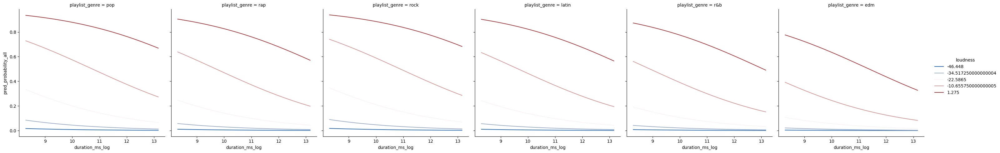

In [233]:
g = sns.relplot(data = dfviz, x='duration_ms_log', y='pred_probability_all', 
                hue='loudness', 
                col='playlist_genre',
                kind='line', 
                palette='vlag', estimator=None, units='loudness')

plt.show()

#### Interpretation
👉 The above plot shows that regardless of genre shorter and louder songs tend to be more popular

### Visualize predicted probability using the BEST model

#### Plot

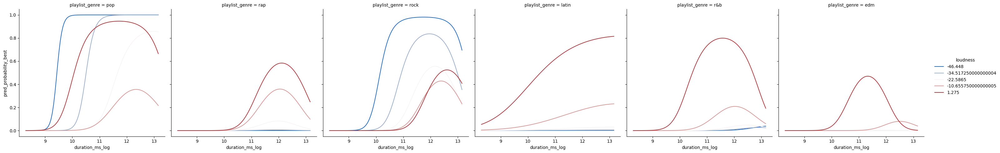

In [234]:
g= sns.relplot(data = dfviz, x='duration_ms_log', y='pred_probability_best', 
               hue='loudness', 
               col='playlist_genre',
               kind='line', 
               palette='vlag', estimator=None, units='loudness')

plt.show()

#### Interpretation

👉 Loudness consistently boosts predicted probability

👉 Different genres have different peak points, reflecting that ideal track length and how it interacts with loudness may vary widely depending on the genre.

## F. Models: Performance and Validation 

In [235]:
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=101)
kf.get_n_splits()

5

In [236]:
input_names = df.drop(columns=['y']).copy().columns.to_list()
input_names

['playlist_genre',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'duration_ms',
 'track_popularity_bin',
 'release_year_bin',
 'speechiness_log',
 'acousticness_log',
 'instrumentalness_log',
 'liveness_log',
 'duration_ms_log']

In [237]:
output_name = 'y'

In [238]:
def train_and_test_logistic_with_cv(mod_name, a_formula, data_df, x_names, y_name, cv, threshold=0.5):
    # separate the inputs and output
    input_df = data_df.loc[ :, x_names ].copy()
    
    # initialize the performance metric storage lists
    train_res = []
    test_res = []
    
    # SPLIT the data and iterate over the folds
    for train_id, test_id in cv.split( input_df.to_numpy(), data_df[ y_name ].to_numpy() ):
        # subset the training and test splits within each fold
        train_data = data_df.iloc[ train_id, :].copy()
        test_data = data_df.iloc[ test_id, :].copy()
        
        # FIT the model on the TRAINING data within the current FOLD
        a_mod = smf.logit(formula=a_formula, data=train_data).fit()
        
        # PREDICT the TRAINING within each FOLD
        train_copy = train_data.copy()
        train_copy['pred_probability'] = a_mod.predict( train_data )
        train_copy['pred_class'] = np.where( train_copy.pred_probability > threshold, 1, 0 )
        
        # PREDICT the TESTING within each FOLD
        test_copy = test_data.copy()
        test_copy['pred_probability'] = a_mod.predict( test_data )
        test_copy['pred_class'] = np.where( test_copy.pred_probability > threshold, 1, 0)
        
        # calculate the PERFORMANCE METRIC on the TRAINING SET within the FOLD
        train_res.append( np.mean( train_copy[ y_name ] == train_copy.pred_class ) )
        
        # calculate the PERFORMANCE METRIC on the TESTING SET within the FOLD
        test_res.append( np.mean( test_copy[ y_name ] == test_copy.pred_class ) )
    
    # book keeping to store the results
    train_df = pd.DataFrame({'Accuracy': train_res})
    train_df['from_set'] = 'training'
    train_df['fold_id'] = train_df.index + 1
    
    test_df = pd.DataFrame({'Accuracy': test_res})
    test_df['from_set'] = 'testing'
    test_df['fold_id'] = test_df.index + 1
    
    # combine the splits together
    res_df = pd.concat([train_df, test_df], ignore_index=True)
    
    # add information about the model
    res_df['model_name'] = mod_name
    res_df['model_formula'] = a_formula
    res_df['num_coefs'] = len( a_mod.params )
    res_df['threshold'] = threshold
    
    return res_df

In [239]:
results_list = []

for m in range( len(formula_list) ):
    print( '-- Formula ID %d --' % m )
    
    try:
        results_list.append( train_and_test_logistic_with_cv(m, formula_list[m], data_df=df, x_names=input_names, y_name=output_name, cv=kf) )
    except:
        # what happens if there is an ERROR
        print( ' !!! Formula ID %d could NOT fit !!! ' % m)

-- Formula ID 0 --
Optimization terminated successfully.
         Current function value: 0.659211
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.659226
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.659226
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.659226
         Iterations 4
Optimization terminated successfully.
         Current function value: 0.659226
         Iterations 4
-- Formula ID 1 --
Optimization terminated successfully.
         Current function value: 0.635259
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.635084
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.634771
         Iterations 5
Optimization terminated successfully.
         Current function value: 0.636872
         Iterations 5
Optimization terminated successfully.
      

In [240]:
cv_results = pd.concat(results_list, ignore_index=True )

In [241]:
cv_results.model_name.value_counts()

model_name
0    10
1    10
2    10
3    10
4    10
5    10
6    10
7    10
Name: count, dtype: int64

In [242]:
cv_results['model_name'] = cv_results['model_name'].astype('category')

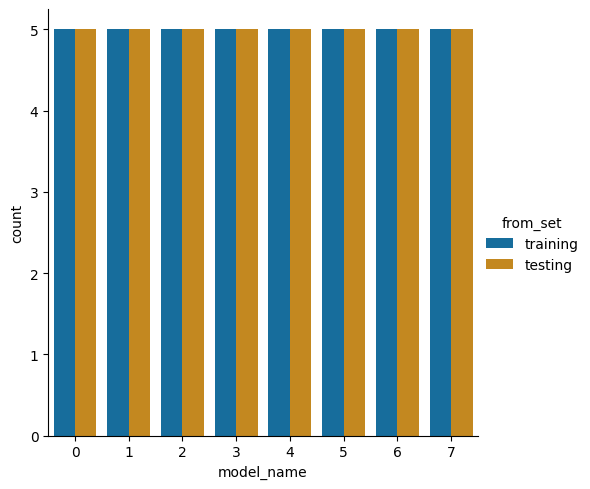

In [243]:
sns.catplot(data = cv_results, x='model_name', hue='from_set', kind='count')

plt.show()

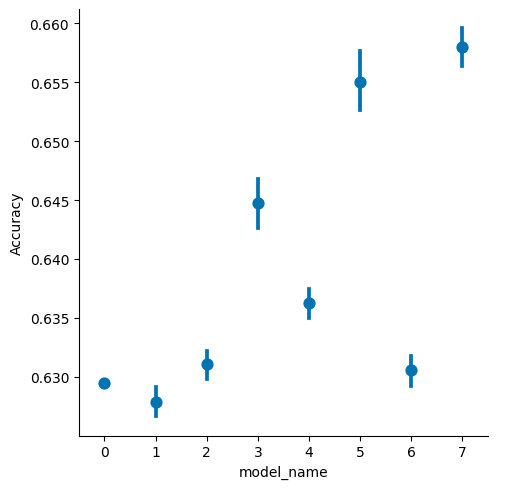

In [244]:
sns.catplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
            x='model_name', y='Accuracy', kind='point', linestyle='none',
            errorbar=('ci', 68))

plt.show()

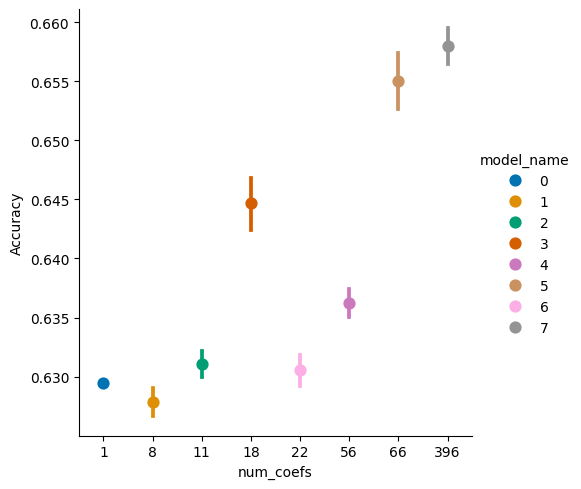

In [245]:
sns.catplot(data = cv_results.loc[ cv_results.from_set == 'testing', :],
            x='num_coefs', y='Accuracy', kind='point', linestyle='none',
            hue='model_name',
            errorbar=('ci', 68))

plt.show()

### Model Selection

🌟 Based on the above POINT PLOT, **Model 5** is the new **BEST model** because it has lesser coefficients and within the margin of error of the previous best model Model 7 🌟

In [246]:
best_model = smf.logit( formula=formula_list[5], data=df).fit()

Optimization terminated successfully.
         Current function value: 0.612935
         Iterations 7


In [247]:
dfviz['pred_probability'] = best_model.predict( input_grid )

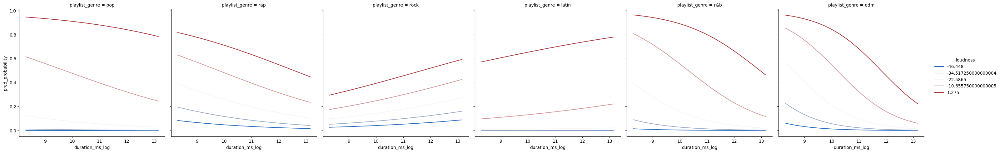

In [248]:
g= sns.relplot(data = dfviz, x='duration_ms_log', y='pred_probability', 
               hue='loudness', 
               col='playlist_genre',
               kind='line', 
               palette='vlag', estimator=None, units='loudness')

plt.show()

#### Interpretation
👉 Predicted Probability depends on both `loudness` and `duration_ms`

👉 Loudness consistently boosts predicted probability

👉 The effect of duration on predicted probability differs based on genre

________________________________________________________________________________________